In [21]:
!kaggle datasets download -d shriyashjagtap/fraudulent-e-commerce-transactions
!unzip fraudulent-e-commerce-transactions.zip

Dataset URL: https://www.kaggle.com/datasets/shriyashjagtap/fraudulent-e-commerce-transactions
License(s): MIT
fraudulent-e-commerce-transactions.zip: Skipping, found more recently modified local copy (use --force to force download)


'unzip' n�o � reconhecido como um comando interno
ou externo, um programa oper�vel ou um arquivo em lotes.


In [22]:
# ETL/EDA
import zipfile
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from sklearn.preprocessing import scale
import plotly.express as px

import warnings

# Ignore all warnings in Jupyter notebook
warnings.filterwarnings("ignore")

# Chart Decorations
plt.style.use("dark_background")

palette = ["#50e991" ,'#e60049']
categorical = [ "#50e991", "#e60049", "#0bb4ff", "#e6d800", "#9b19f5", "#ffa300", "#dc0ab4", "#b3d4ff", "#00bfa0"]
classes = {0:palette[0], 
         1:palette[1]}

Unzipping files

In [47]:
zip_filename = "fraudulent-e-commerce-transactions.zip"
destination_folder = 'data/'

with zipfile.ZipFile(zip_filename, 'r') as zip_ref:
    if not os.path.exists(destination_folder):
        zip_ref.extractall(destination_folder)
        # renaming the files
        old_filenames = os.listdir('data/')
        os.rename(os.path.join(destination_folder, old_filenames[0]), os.path.join(destination_folder, 'fraud_train.csv'))
        os.rename(os.path.join(destination_folder, old_filenames[1]), os.path.join(destination_folder, 'fraud_val.csv'))
    else: 
        print("Destination already exists.")

if os.path.exists(zip_filename):
    os.remove(zip_filename)

Destination already exists.


# Data Card and Understanding

1. **transaction ID:** A unique identifier for each transaction.

2. **Customer ID:** A unique identifier for each customer.

3. **Transaction Amount:** The total amount of money exchanged in the transaction.

4. **Transaction Date:** The date and time when the transaction took place.

5. **Payment Method:** The method used to complete the transaction (e.g., credit card, PayPal, etc.).

6. **Product Category:** The category of the product involved in the transaction.

7. **Quantity:** The number of products involved in the transaction.

8. **Customer Age:** The age of the customer making the transaction.

9. **Customer Location:** The geographical location of the customer.

10. **Device Used:** The type of device used to make the transaction (e.g., mobile, desktop).

11. **IP Address:** The IP address of the device used for the transaction.

12. **Shipping Address:** The address where the product was shipped.

13. **Billing Address:** The address associated with the payment method.

14. **Is Fraudulent:** A binary indicator of whether the transaction is fraudulent (1 for fraudulent, 0 for legitimate).

15. **Account Age Days:** The age of the customer's account in days at the time of the transaction.

16. **Transaction Hour:** The hour of the day when the transaction occurred.

In [24]:
df = pd.read_csv("data/fraud_train.csv")
df.head()

,Transaction ID,Customer ID,Transaction Amount,Transaction Date,Payment Method,Product Category,Quantity,Customer Age,Customer Location,Device Used,IP Address,Shipping Address,Billing Address,Is Fraudulent,Account Age Days,Transaction Hour
0,15d2e414-8735-46fc-9e02-80b472b2580f,d1b87f62-51b2-493b-ad6a-77e0fe13e785,58.09,2024-02-20 05:58:41,bank transfer,electronics,1,17,Amandaborough,tablet,212.195.49.198,Unit 8934 Box 0058\nDPO AA 05437,Unit 8934 Box 0058\nDPO AA 05437,0,30,5
1,0bfee1a0-6d5e-40da-a446-d04e73b1b177,37de64d5-e901-4a56-9ea0-af0c24c069cf,389.96,2024-02-25 08:09:45,debit card,electronics,2,40,East Timothy,desktop,208.106.249.121,"634 May Keys\nPort Cherylview, NV 75063","634 May Keys\nPort Cherylview, NV 75063",0,72,8
2,e588eef4-b754-468e-9d90-d0e0abfc1af0,1bac88d6-4b22-409a-a06b-425119c57225,134.19,2024-03-18 03:42:55,PayPal,home & garden,2,22,Davismouth,tablet,76.63.88.212,"16282 Dana Falls Suite 790\nRothhaven, IL 15564","16282 Dana Falls Suite 790\nRothhaven, IL 15564",0,63,3
3,4de46e52-60c3-49d9-be39-636681009789,2357c76e-9253-4ceb-b44e-ef4b71cb7d4d,226.17,2024-03-16 20:41:31,bank transfer,clothing,5,31,Lynnberg,desktop,207.208.171.73,"828 Strong Loaf Apt. 646\nNew Joshua, UT 84798","828 Strong Loaf Apt. 646\nNew Joshua, UT 84798",0,124,20
4,074a76de-fe2d-443e-a00c-f044cdb68e21,45071bc5-9588-43ea-8093-023caec8ea1c,121.53,2024-01-15 05:08:17,bank transfer,clothing,2,51,South Nicole,tablet,190.172.14.169,"29799 Jason Hills Apt. 439\nWest Richardtown, ...","29799 Jason Hills Apt. 439\nWest Richardtown, ...",0,158,5


In [25]:
df.isnull().sum()

Transaction ID        0
Customer ID           0
Transaction Amount    0
Transaction Date      0
Payment Method        0
Product Category      0
Quantity              0
Customer Age          0
Customer Location     0
Device Used           0
IP Address            0
Shipping Address      0
Billing Address       0
Is Fraudulent         0
Account Age Days      0
Transaction Hour      0
dtype: int64

- No missing values

In [26]:
df.describe()

,Transaction Amount,Quantity,Customer Age,Is Fraudulent,Account Age Days,Transaction Hour
count,1.472952e+06,1.472952e+06,1.472952e+06,1.472952e+06,1.472952e+06,1.472952e+06
mean,2.267683e+02,3.000230e+00,3.451208e+01,5.012926e-02,1.796464e+02,1.128696e+01
std,2.703951e+02,1.414736e+00,1.000313e+01,2.182117e-01,1.068642e+02,6.975995e+00
min,1.000000e+01,1.000000e+00,-1.600000e+01,0.000000e+00,1.000000e+00,0.000000e+00
25%,6.861000e+01,2.000000e+00,2.800000e+01,0.000000e+00,8.600000e+01,5.000000e+00
50%,1.517600e+02,3.000000e+00,3.500000e+01,0.000000e+00,1.790000e+02,1.100000e+01
75%,2.960500e+02,4.000000e+00,4.100000e+01,0.000000e+00,2.720000e+02,1.700000e+01
max,1.270175e+04,5.000000e+00,8.600000e+01,1.000000e+00,3.650000e+02,2.300000e+01


In [27]:
duplicated_rows = df[df.duplicated()]
duplicated_rows

,Transaction ID,Customer ID,Transaction Amount,Transaction Date,Payment Method,Product Category,Quantity,Customer Age,Customer Location,Device Used,IP Address,Shipping Address,Billing Address,Is Fraudulent,Account Age Days,Transaction Hour


- No duplicated values.

# Data Cleaning

In [28]:
# Lowercasing column names
df.columns = [col.lower() for col in df.columns]
df.columns

Index(['transaction id', 'customer id', 'transaction amount',
       'transaction date', 'payment method', 'product category', 'quantity',
       'customer age', 'customer location', 'device used', 'ip address',
       'shipping address', 'billing address', 'is fraudulent',
       'account age days', 'transaction hour'],
      dtype='object')

In [29]:
df.dtypes

transaction id         object
customer id            object
transaction amount    float64
transaction date       object
payment method         object
product category       object
quantity                int64
customer age            int64
customer location      object
device used            object
ip address             object
shipping address       object
billing address        object
is fraudulent           int64
account age days        int64
transaction hour        int64
dtype: object

- I will transform the "transaction date" column to datetime format and separately extract the day, day of the week, and month number.

In [30]:
df['transaction date'] = pd.to_datetime(df['transaction date']) 
df['day'] = df['transaction date'].dt.day
df['weekday'] = df['transaction date'].dt.day_name()
df['month'] = df['transaction date'].dt.month

df['address match'] = (df['billing address'] == df['shipping address']).astype(int)
df['address match'].value_counts()

address match
1    1325429
0     147523
Name: count, dtype: int64

In [31]:
# removing irrelevant features to avoid memory comsumption
df.drop(columns=["transaction id", "customer id", "customer location",
                     "ip address", "transaction date","shipping address","billing address"], inplace=True)

In [32]:
categorical_data = df.select_dtypes(include=['object'])

for col in categorical_data.columns:
    print(f"Number of unique features in {col} : {categorical_data[col].nunique()}")

Number of unique features in payment method : 4
Number of unique features in product category : 5
Number of unique features in device used : 3
Number of unique features in weekday : 7


In [33]:
def pie_bar(data):
    # Calculate percentage of each category
    data_counts = df[data].value_counts()
    total = data_counts.sum()
    data_percentage = data_counts / total * 100 

    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
    
    patches, texts, autotexts = ax1.pie(data_percentage, 
        autopct='%1.1f%%', 
        startangle=45, 
        labels = data_counts.index,
        colors=categorical, 
        pctdistance=0.6, 
        shadow = True,
        wedgeprops=dict(width=0.8, edgecolor='black'),
        textprops = {"color":"black"})  

    for text in texts:
        text.set_color("white")

    # Bar chart
    ax2 = sns.countplot(data = df, x=data, hue = data, palette = categorical)

    for container in ax2.containers:
        ax2.bar_label(container)

    fig.suptitle(f"Pie and Bar chart for {data}", fontsize = 16)
    plt.tight_layout()
    return plt.show()


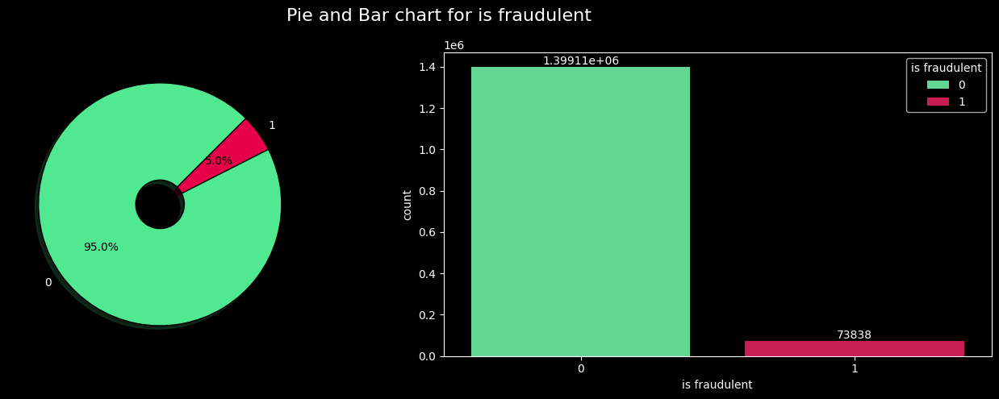

In [34]:
pie_bar('is fraudulent')

- The dataset contains fewer fraudulent transactions compared to non-fraudulent ones.

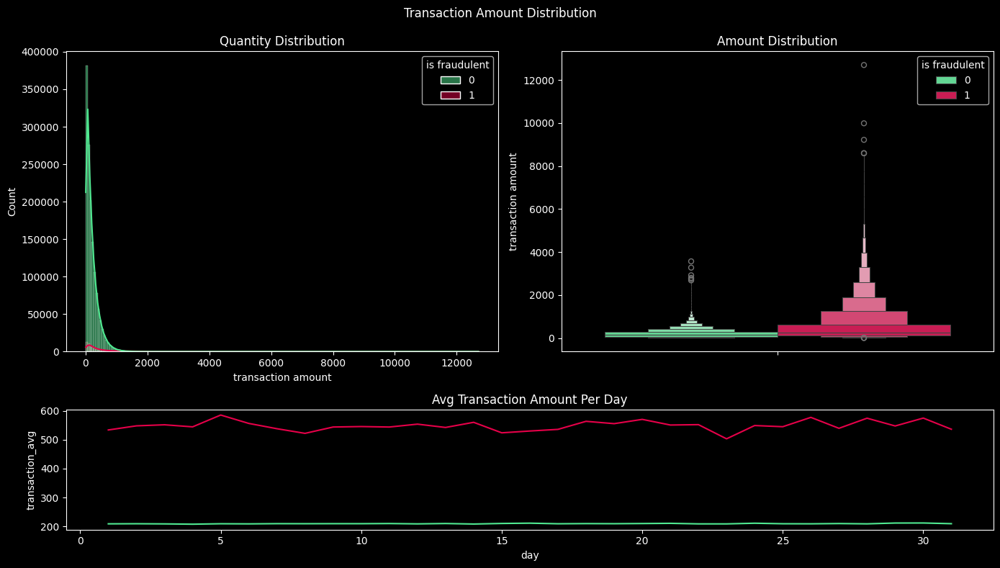

In [35]:
daily_transaction = df.groupby(["day", 'is fraudulent'])['transaction amount'].mean().reset_index(name = 'transaction_avg')

#fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
fig = plt.figure(figsize=(14,8))
gs = fig.add_gridspec(2,2, height_ratios=[0.5, 0.2])

# Create the subplots
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[1, :])


ax1 = sns.histplot(data = df, x ='transaction amount', hue = 'is fraudulent',  kde = True, palette = palette, bins = 200, ax = ax1)
ax1.set_title("Quantity Distribution")

ax2 = sns.boxenplot(data = df, y = 'transaction amount', hue = 'is fraudulent', palette=palette, ax=ax2)
ax2.set_title("Amount Distribution")

ax3 = sns.lineplot(data = daily_transaction, x = daily_transaction['day'], y = daily_transaction['transaction_avg'], hue = 'is fraudulent', palette=palette, ax=ax3)
ax3.set_title('Avg Transaction Amount Per Day')
ax3.legend().remove()

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.suptitle("Transaction Amount Distribution")
plt.show()

- Transactions exceeding 4000 are predominantly fraudulent.
- Fraudulent transactions tend to have higher amounts.

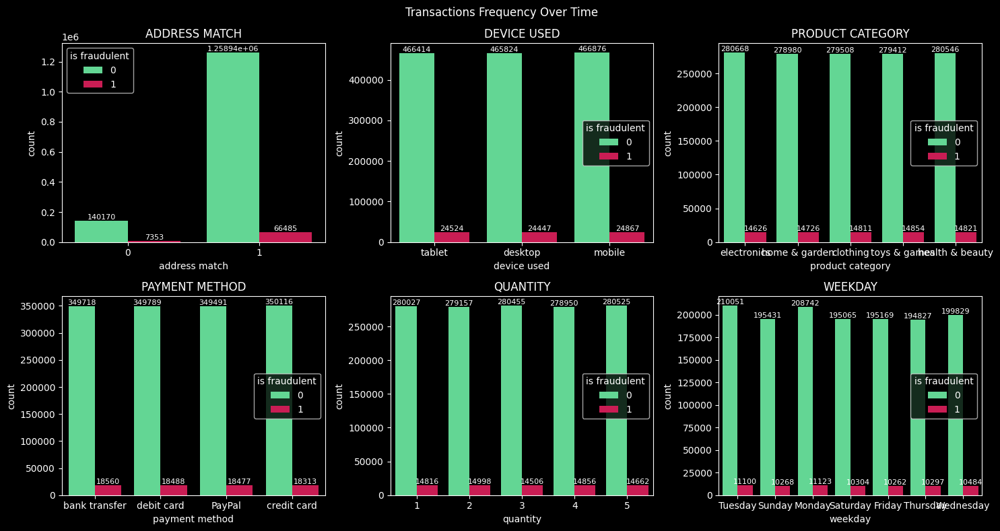

In [36]:
plt.figure(figsize=(15,8))
plt.subplots_adjust(hspace=0.5)
plt.suptitle("Transactions Frequency Over Time")

col_names = ['address match', 'device used', 'product category', 'payment method', 'quantity', 'weekday']

for n, col in enumerate(col_names):

    ax = plt.subplot(2, 3, n+1)
    sns.countplot(data = df, x = col, hue="is fraudulent",  palette=palette, legend = True)    

    for container in ax.containers:
        ax.bar_label(container, fontsize = 8)

    ax.set_title(col.upper())

plt.tight_layout()
plt.show()

In [37]:
fig = px.box(df, x='customer age', title="Customer Age Distribution", template='plotly_dark')

fig.update_traces(marker=dict(color='#50e991', outliercolor='#ff6347', line=dict(outliercolor='#ff6347', outlierwidth=2)))
fig.show()

Given the summary statistics of the boxplot for customer age, it is clear that the data contains outliers and potentially erroneous values.

- Specifically, the lower fence outliers indicate ages smaller than 9, including impossible values like negative ages.

- To approach this problem, I will replace values less than -9 by their absolute values (e.g. age -5 will be age = 5) and values between -9 and 8 with the age mean.

In [38]:
mean_age = round(df['customer age'].mean(),0)
df['customer age'] = df['customer age'].apply(lambda x: abs(x) if x < -9 else x)
df['customer age'] = df['customer age'].apply(lambda x: mean_age if -9 <= x <=8 else x)

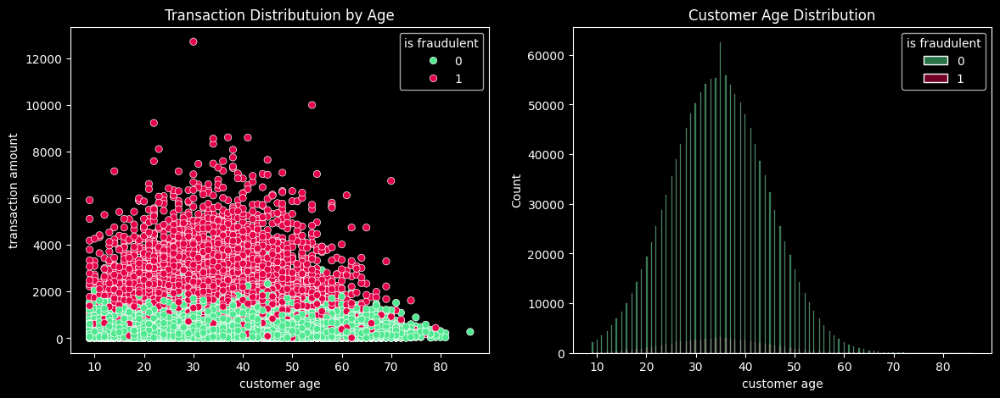

In [39]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))


ax1=sns.scatterplot(data=df, y = 'transaction amount', x='customer age', hue='is fraudulent', palette=palette, ax = ax1)
ax1.set_title("Transaction Distributuion by Age")

ax2=sns.histplot(data=df, x="customer age", hue='is fraudulent', palette=palette, ax = ax2)
ax2.set_title("Customer Age Distribution")
plt.show()

- Customer Age follows a normal distributon.

- The average customer age is approximately 35 years.

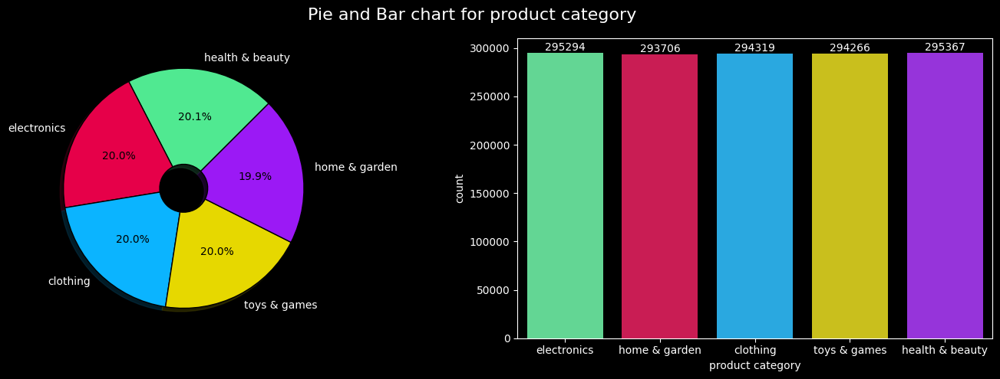

In [40]:
pie_bar('product category')

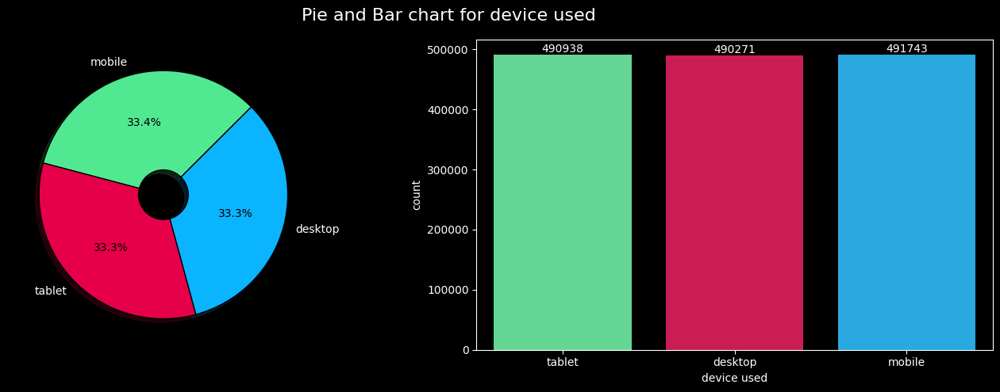

In [41]:
pie_bar('device used')

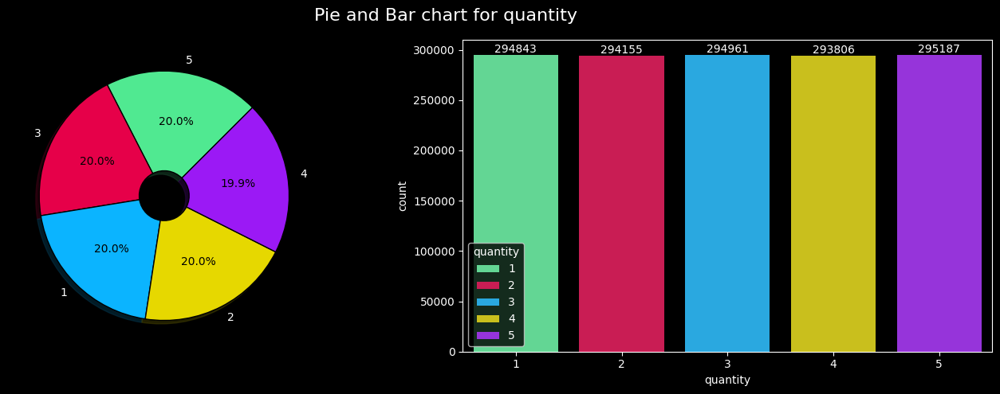

In [42]:
pie_bar('quantity')

<Figure size 1000x500 with 0 Axes>

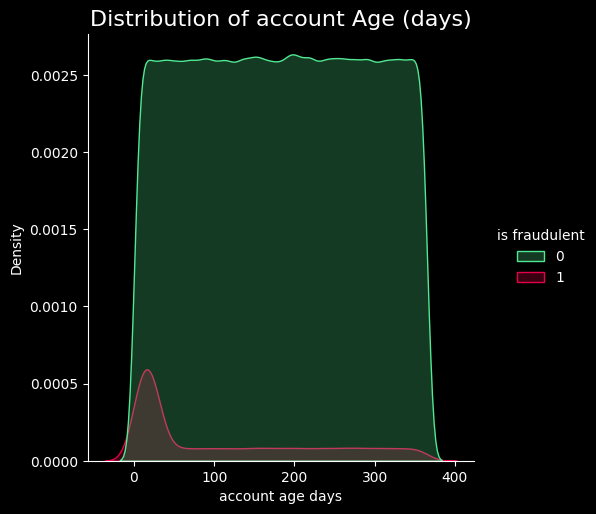

In [43]:
plt.figure(figsize=(10, 5))
sns.displot(data = df, x='account age days', hue = 'is fraudulent', palette = palette, kind = "kde", fill = True)
#sns.move_legend(ax, 'upper right', bbox_to_anchor=(1, 1))
plt.title("Distribution of account Age (days)", fontsize=16)
plt.show()

- Accounts created recently exhibit a higher tendency for fraudulent activity.

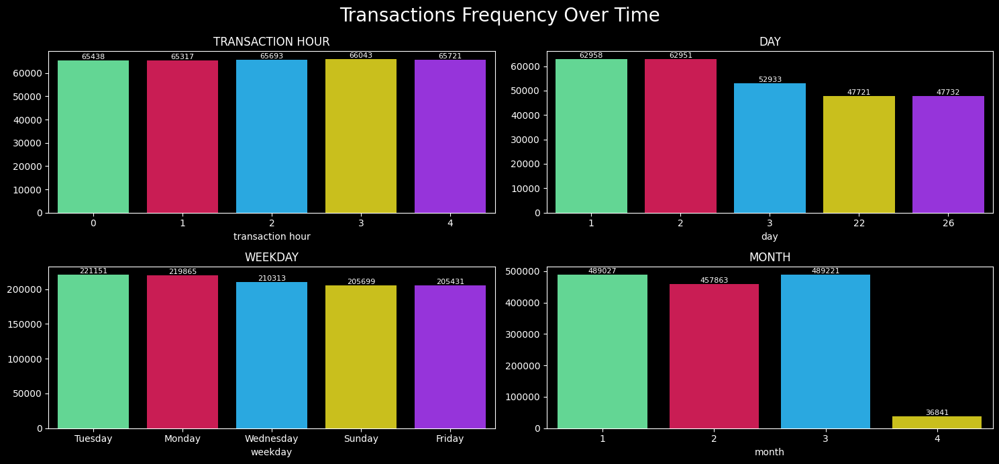

In [44]:
plt.figure(figsize=(15,7))
plt.subplots_adjust(hspace=0.5)
plt.suptitle("Transactions Frequency Over Time", fontsize = 20)

col_names = ['transaction hour', 'day', 'weekday', 'month']

for n, col in enumerate(col_names):

    count_data = df[col].value_counts().sort_values(ascending=False).head(5)

    ax = plt.subplot(2, 2, n+1)
    sns.barplot(x = count_data.index, y = count_data.values, hue=count_data.index,  palette=categorical[:5], legend = False)    

    for container in ax.containers:
        ax.bar_label(container, fontsize = 8)

    ax.set_title(col.upper())

plt.tight_layout()
plt.show()
